Looking for flares in all the STIS data. MEATS version

In [33]:
import numpy as np
import matplotlib.pyplot as plt
import astropy.io.fits as fits
import os
import glob
from astropy.table import Table
from astropy.io import ascii
import astropy.units as u
import astropy.constants as const
from matplotlib import cm
from scipy import interpolate
from astropy.convolution import convolve, Box1DKernel, convolve_fft, Gaussian1DKernel
import matplotlib.patches as mpatches
from astropy.modeling import models, fitting
from astropy.units import cds
cds.enable()

#matplotlib set up
%matplotlib inline
from matplotlib import rcParams
rcParams["figure.figsize"] = (14, 5)
rcParams["font.size"] = 20

In [34]:
path = '/media/david/2tb_ext_hd/hddata/meats/flare_search/data/'

In [35]:
tags = glob.glob('{}*tag.fits'.format(path))

In [36]:
g140ms = []
g140m_stars = []
e140ms = []
e140m_stars = []
g140ls = []
g140l_stars = []
g230ls = []
g230l_stars = []
for tag in tags:
    grating = fits.getheader(tag, 0)['OPT_ELEM']
    star = fits.getheader(tag, 0)['TARGNAME']
    if grating == 'E140M':
        e140ms.append(tag)
        e140m_stars.append(star)
    elif grating == 'G140M':
        g140ms.append(tag)
        g140m_stars.append(star)
    elif grating == 'G140L':
        g140ls.append(tag)
        g140l_stars.append(star)
    elif grating == 'G230L':
        g230ls.append(tag)
        g230l_stars.append(star)
        
    else:
        print ('Unknown grating: {}'.format(grating))

g140m_stars = np.unique(g140m_stars)
g140l_stars = np.unique(g140l_stars)
e140m_stars = np.unique(e140m_stars)


In [37]:
outpath = '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/'

In [38]:
import stistools


In [39]:
t_bin = 20 #in seconds
grating = 'g140l'

use_tags = []
stars = []

for tag in tags:
    grating_i = fits.getheader(tag, 0)['OPT_ELEM']
    star = fits.getheader(tag, 0)['TARGNAME']
    if grating_i.lower() == grating:
        use_tags.append(tag)
        stars.append(star)

stars = np.unique(stars)
print(stars)

['BD-14-1137' 'BD-20-2976' 'CD-23-12010' 'CD-38-3220' 'HATS-72'
 'HD-120411' 'HD-15337' 'HD-80606' 'L-22-69' 'LP-961-53' 'STKM-1-2122'
 'TYC-6991-475-1' 'WOLF-437']


In [40]:

for tag in use_tags:
    print(tag)
    rootname = fits.getheader(tag)['ROOTNAME'] #find the rootname of the tagfile to name the output file
    exptime = fits.getheader(tag)['TEXPTIME']
    n_bins = int(exptime/t_bin) #use the exposure time to tell inttag how many time bins there will be
    print('n_bins = {}'.format(n_bins) )
    if n_bins > 0:
        outfile = '{}{}/{}_{}s_raw.fits'.format(outpath, grating, rootname, t_bin) #build the file path and file name of the output
        if os.path.exists(outfile) == False:
            # os.remove(outfile)
            stistools.inttag.inttag(tag, outfile, rcount = n_bins, increment = t_bin, verbose=False) #change verbose to true to diagnose problems

/media/david/2tb_ext_hd/hddata/meats/flare_search/data/oeoo02010_tag.fits
n_bins = 105
/media/david/2tb_ext_hd/hddata/meats/flare_search/data/oeoo07010_tag.fits
n_bins = 109
/media/david/2tb_ext_hd/hddata/meats/flare_search/data/oeoo07020_tag.fits
n_bins = 129
/media/david/2tb_ext_hd/hddata/meats/flare_search/data/oeoo07030_tag.fits
n_bins = 129
/media/david/2tb_ext_hd/hddata/meats/flare_search/data/oeoo09030_tag.fits
n_bins = 122
/media/david/2tb_ext_hd/hddata/meats/flare_search/data/oeoo09040_tag.fits
n_bins = 103
/media/david/2tb_ext_hd/hddata/meats/flare_search/data/oeoo14010_tag.fits
n_bins = 105
/media/david/2tb_ext_hd/hddata/meats/flare_search/data/oeoo14020_tag.fits
n_bins = 125
/media/david/2tb_ext_hd/hddata/meats/flare_search/data/oeoo14030_tag.fits
n_bins = 125
/media/david/2tb_ext_hd/hddata/meats/flare_search/data/oeoo15010_tag.fits
n_bins = 105
/media/david/2tb_ext_hd/hddata/meats/flare_search/data/oeoo15020_tag.fits
n_bins = 125
/media/david/2tb_ext_hd/hddata/meats/flare_

In [41]:
os.environ['oref'] = path 

In [42]:
raws = glob.glob('{}{}/*raw.fits'.format(outpath, grating))
raws

['/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo02010_20s_raw.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo07010_20s_raw.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo07020_20s_raw.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo07030_20s_raw.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo24020_20s_raw.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo24030_20s_raw.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo25010_20s_raw.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo29040_20s_raw.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo30010_20s_raw.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo30020_20s_raw.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo30030_20s_raw.fits',
 '/media/d

In [43]:
for raw in raws:
    rootname = fits.getheader(raw)['ROOTNAME'] 
    outname = '{}{}/{}_{}s'.format(outpath, grating, rootname, t_bin) #build the file path and file name of the output
    # print(outname)
    # if os.path.exists(outname):
    #     os.remove(outname)
    if os.path.exists(outname+'_x1d.fits') == False:
        print('making {}'.format(rootname))
        
        stistools.calstis.calstis(raw, outroot = outname, wavecal='{}{}_wav.fits'.format(path, rootname), trailer='trls/{}_{}s_extract.trl'.format(rootname,t_bin))

making oeoo07020
making oeoo30010
making oeoo30020
making oeoo30030
making oeoo30040
making oeoo25020


In [44]:
new_x1ds = glob.glob('{}{}/*{}s*x1d.fits'.format(outpath, grating, t_bin))
new_x1ds

['/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo02010_20s_x1d.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo07010_20s_x1d.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo07030_20s_x1d.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo24010_20s_x1d.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo24020_20s_x1d.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo24030_20s_x1d.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo25010_20s_x1d.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo29030_20s_x1d.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo29040_20s_x1d.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo09030_20s_x1d.fits',
 '/media/david/2tb_ext_hd/hddata/meats/flare_search/output/g140l/oeoo09040_20s_x1d.fits',
 '/media/d

oeoo02010
oeoo07010
oeoo07030
oeoo24010
oeoo24020
oeoo24030
oeoo25010
oeoo29030
oeoo29040
oeoo09030
oeoo09040
oeoo14010
oeoo14020
oeoo27010
oeoo14030
oeoo15010
oeoo15020
oeoo17010
oeoo19010
oeoo20020
oeoo22010
oeoo25030
oeoo26010
oeoo26020
oeoo27020
oeoo27030
oeoo27040
oeoo28010
oeoo28020
oeoo29010
oeoo29020
oeoo32010
oeoo32020
oeoo32030
oeoo39010
oeoo39020
oeoo39030
oeoo40010
oeoo40020
oeoo42010
oeoo43010
oeoo44010
oeoo44020


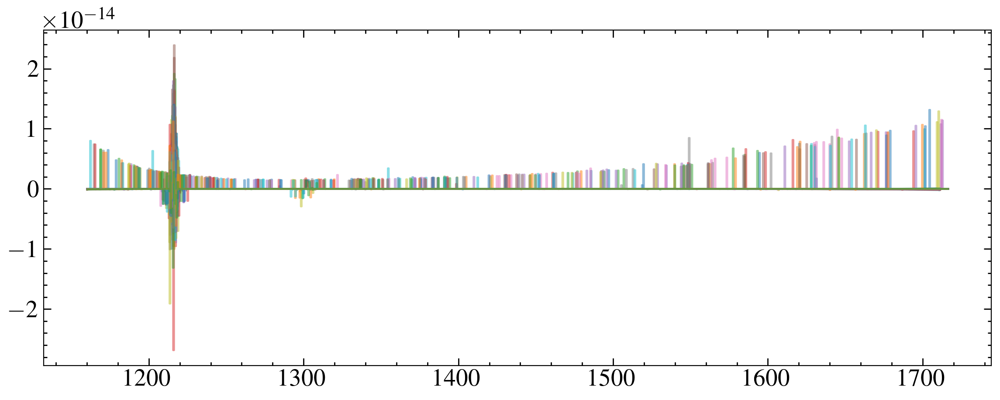

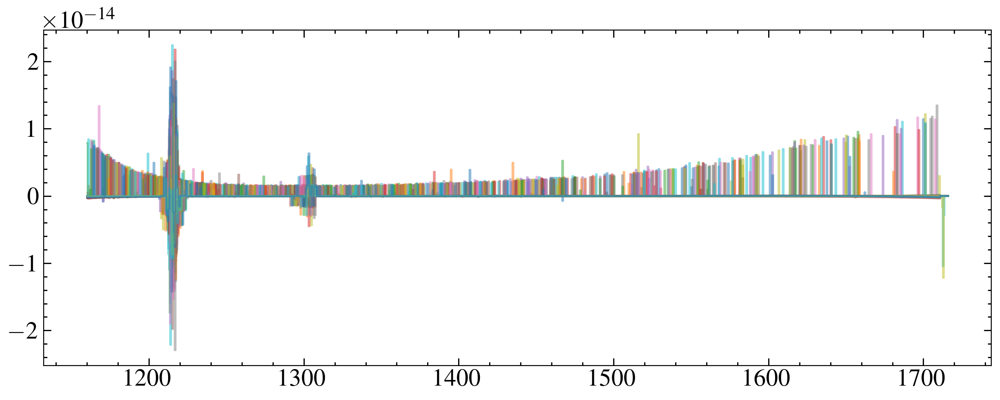

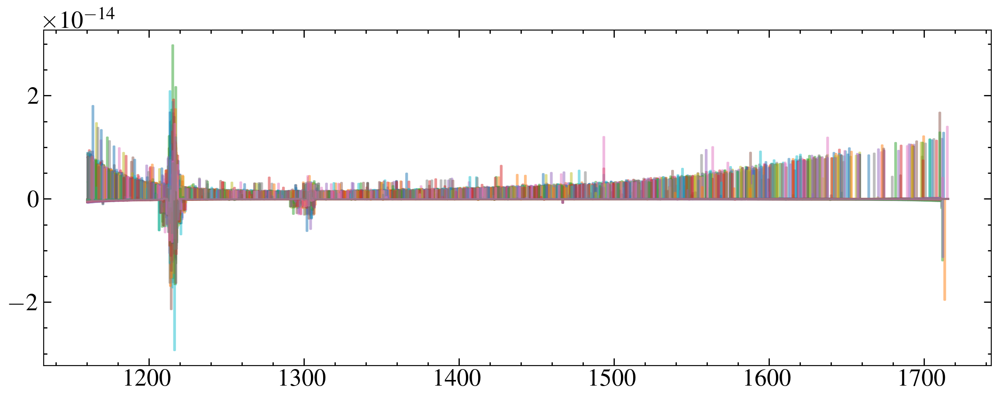

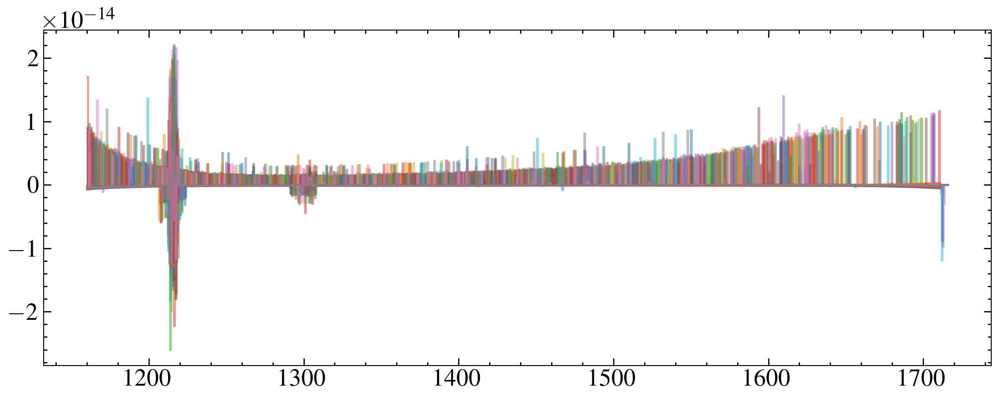

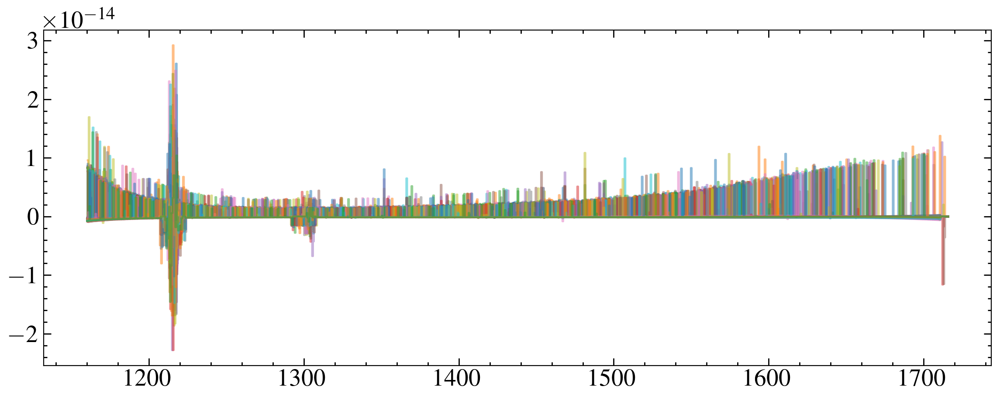

...

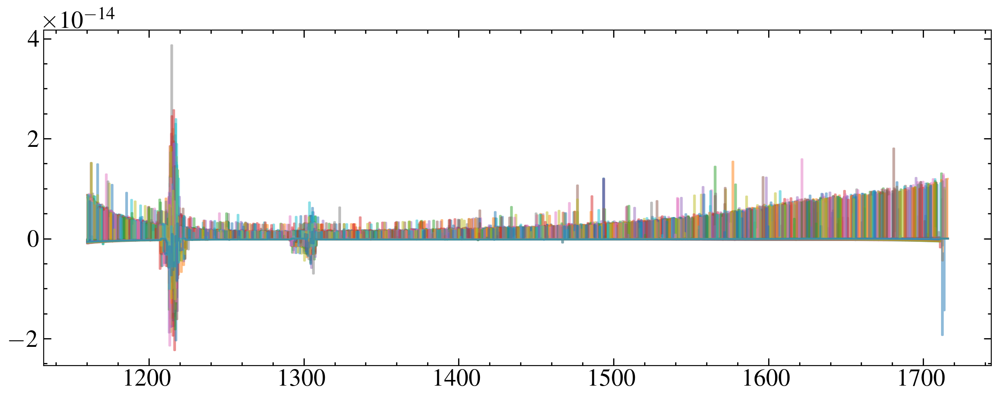

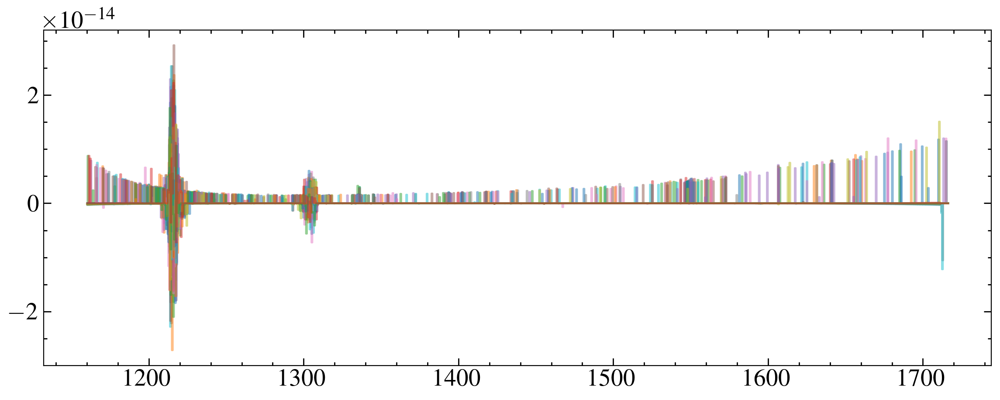

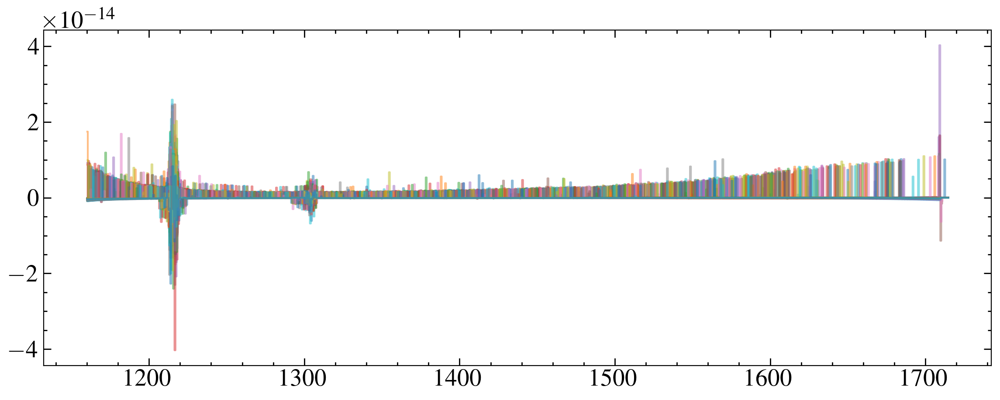

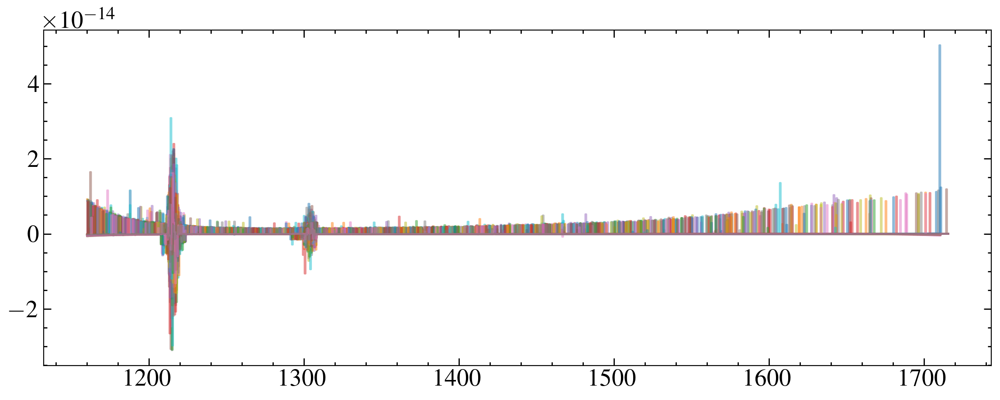

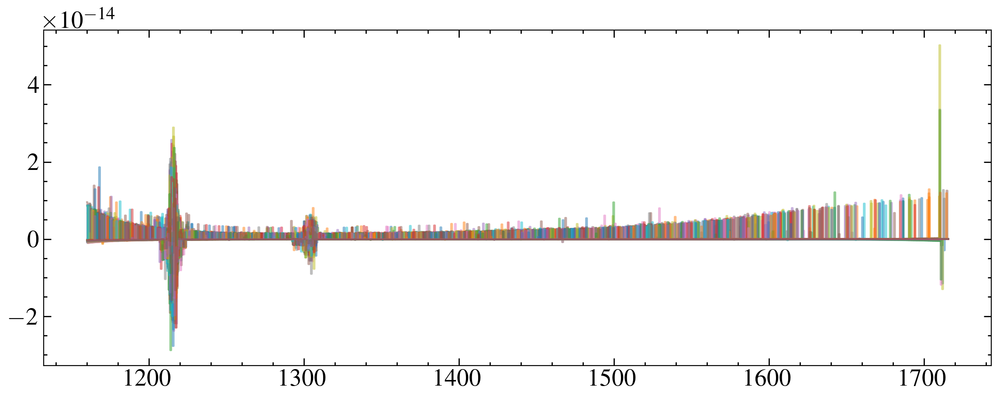

In [45]:
for x in new_x1ds:
    fig, ax = plt.subplots()
    hdul = fits.open(x)
    print(hdul[0].header['ROOTNAME'])
    for ext in hdul[1::]: #spectra in every extension after the first
        data = ext.data
        for dt in data:
            mask = dt['WAVELENGTH'] > 1160
            ax.step(dt['WAVELENGTH'][mask], dt['FLUX'][mask], where='mid', alpha=0.5)
        # plt.step(data['WAVELENGTH'], data['ERROR'], alpha =0.5, where='mid')
        # ax.set_ylim(0, 1.1*max(data['FLUX']))
        # plt.show()
    hdul.close()
    # plt.show()
    

In [46]:
def spectra_adder(f_array, e_array, scale_correct=True):
    """
    Returns a variance-weighted coadd with standard error of the weighted mean (variance weights, scale corrected).
    f_array and e_arrays are collections of flux and error arrays, which should have the same lenth and wavelength scale
    """
    weights = 1 / (e_array**2)
    flux = np.average(f_array, axis =0, weights = weights)
    var = 1 / np.sum(weights, axis=0)
    rcs = np.sum((((flux - f_array)**2) * weights), axis=0) / (len(f_array)-1) #reduced chi-squared
    if scale_correct:
        error = (var * rcs)**0.5
    else:
        error = var**0.5
    return flux,error

def echelle_coadd_dq(wavelength, flux, err, dq, nclip =5, find_ratio =True, dq_adjust=False, dq_cut =0):
    """
    combines echelle orders into one spectrum, stiching them together at the overlap 
    """
    #slice dodgy ends off orders (usually 5-10 for stis el40m)
    wavelength = wavelength[:, nclip:-(nclip+1)]
    flux = flux[:, nclip:-(nclip+1)]
    err = err[:, nclip:-(nclip+1)]
    dq = dq[:, nclip:-(nclip+1)]
    
    #new arrays to put the output in
    w_full = np.array([], dtype=float)
    f_full = np.array([], dtype=float)
    e_full = np.array([], dtype=float)
    dq_full = np.array([], dtype=int)
    if find_ratio:
        r_full = np.array([], dtype=float) #ratio between orders

    shape = np.shape(flux)
    order = 0
    while order < (shape[0]):
        
        #first add the part that does not overlap ajacent orders to the final spectrum
        if order == 0: #first and last orders do not overlap at both ends
            overmask = (wavelength[order] > wavelength[order + 1][-1])
        elif order == shape[0]-1:
            overmask = (wavelength[order] < wavelength[order - 1][1])
        else:
            overmask = (wavelength[order] > wavelength[order + 1][-1]) & (wavelength[order] < wavelength[order - 1][1])
        w_full = np.concatenate((w_full, wavelength[order][overmask]))
        f_full = np.concatenate((f_full, flux[order][overmask]))
        e_full = np.concatenate((e_full, err[order][overmask]))
        dq_full = np.concatenate((dq_full, dq[order][overmask]))
        if find_ratio:
            r_full = np.concatenate((r_full, np.full(len(err[order][overmask]), -1)))
  
        if order != shape[0]-1:
            
            #interpolate each order onto the one beneath it, with larger wavelength bins. Code adapted from stisblazefix
            f = interpolate.interp1d(wavelength[order + 1], flux[order + 1], fill_value='extrapolate')
            g = interpolate.interp1d(wavelength[order + 1], err[order + 1], fill_value='extrapolate')
            dqi = interpolate.interp1d(wavelength[order + 1], dq[order + 1], kind='nearest',bounds_error=False, fill_value=0)
            overlap = np.where(wavelength[order] <= wavelength[order + 1][-1])
            f0 = flux[order][overlap]
            f1 = f(wavelength[order][overlap])
            g0 = err[order][overlap]
            g1 = g(wavelength[order][overlap])
            dq0 = dq[order][overlap]
            dq1 = dqi(wavelength[order][overlap])
       
             
            #combine flux and error at overlap and add to final spectrum
            w_av = wavelength[order][overlap]
            if dq_adjust: #removes values with high dq: #THIS DOESN'T REALLY WORK YET
                if dq_cut == 0:
                    dq_cut = 1 #allows zero to be the default
                for i in range(len(wavelength[order][overlap])):
                    if dq0[i] >= dq_cut:
                        g0 *= 100 #make error very large so it doesn't contribute to the coadd
                    if dq1[i] >= dq_cut:
                        g1 *= 100 
                        
            
            
            f_av, e_av = spectra_adder(np.array([f0,f1]),np.array([g0,g1]))
            dq_av = [(np.sum(np.unique(np.array([dq0, dq1])[:,i]))) for i in range(len(dq0))]
            
            
            w_full = np.concatenate((w_full, w_av))
            f_full = np.concatenate((f_full, f_av))
            e_full = np.concatenate((e_full, e_av))
            dq_full = np.concatenate((dq_full, dq_av))
            
            if find_ratio:
                r_full = np.concatenate((r_full, f0/f1))
        order += 1
    
    #stis orders are saved in reverse order, so combined spectra are sorted by the wavelength array
    arr1inds = w_full.argsort()
    sorted_w = w_full[arr1inds]
    sorted_f = f_full[arr1inds]
    sorted_e = e_full[arr1inds]
    sorted_dq = dq_full[arr1inds]
    if find_ratio:
        sorted_r = r_full[arr1inds]
 
    if find_ratio:
        return sorted_w, sorted_f, sorted_e, sorted_dq, sorted_r
    else:
        return sorted_w, sorted_f, sorted_e, sorted_dq

WOLF-437


/tmp/ipykernel_265135/3068831374.py:41: RuntimeWarning: invalid value encountered in scalar power
  ei = ((fi*t_bin)**0.5)/t_bin # sqrt total counts


0.05924299525102303 0.08516735123520704 1.437593607047347 30.43931225780241
L-22-69
0.046749946655166866 0.10105171321589158 2.1615364389880694 53.73661151564239
L-22-69
0.04535025700014678 0.11053064261796389 2.437266069244241 58.97042130036774
BD-14-1137
0.02270127581111423 0.09173564413985419 4.040990687181629 75.25359305647285
BD-14-1137
0.012673900921615073 0.08655773640650494 6.829604944984423 85.35786464875412
BD-14-1137
0.03573973359310966 0.12434646890663445 3.47922204239954 71.25794249940073
BD-20-2976
0.4285288393527162 0.4715379101392302 1.1003644722056007 9.121020783634298
HATS-72
0.05941110386172094 0.13775740199827288 2.318714735866591 56.87265947243561
HATS-72
0.06516361152317601 0.15754893441418244 2.417744055793298 58.63912900110987
L-22-69
0.04376734532406021 0.08384526854772416 1.9157037724568577 47.79986267305217
L-22-69
0.019124077861677708 0.07620736423517672 3.984890920564953 74.90521020690257
LP-961-53
0.032761913554640254 0.06779733838689773 2.0693949476982003

/tmp/ipykernel_265135/3068831374.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


0.03761464180814129 0.06764999588243659 1.7985016639928355 44.398160979183636
BD-20-2976
0.3430181477778025 0.38766264004860357 1.1301519833863733 11.516325706599877
BD-20-2976
0.43920314465595683 0.45757416998104083 1.041828082400172 4.014873769173899
BD-20-2976
0.10118455845728763 0.24809810881181027 2.4519364673270605 59.21590900395009
HD-120411
4.174656388834185 4.320780221428201 1.0350026011685294 3.3818853333326
HD-120411
4.276643766327824 4.36616474839393 1.0209325319005875 2.0503344977771585
HD-120411
5.6107435297889 5.790469188281646 1.0320324138037207 3.103818579269232
HD-120411
5.028445136272593 5.583702050608618 1.1104231823731536 9.9442432512226
HD-120411
4.339643273421728 4.45236175874191 1.0259741361716366 2.5316560384804148
HATS-72
0.05412985824993698 0.10086699499194307 1.8634261801722067 46.335411048717475
HATS-72
0.05856960251077224 0.11329851839693023 1.9344252571304736 48.305058760274875
CD-38-3220
0.7266972740672029 0.7731081218636301 1.0638654491390527 6.00315098

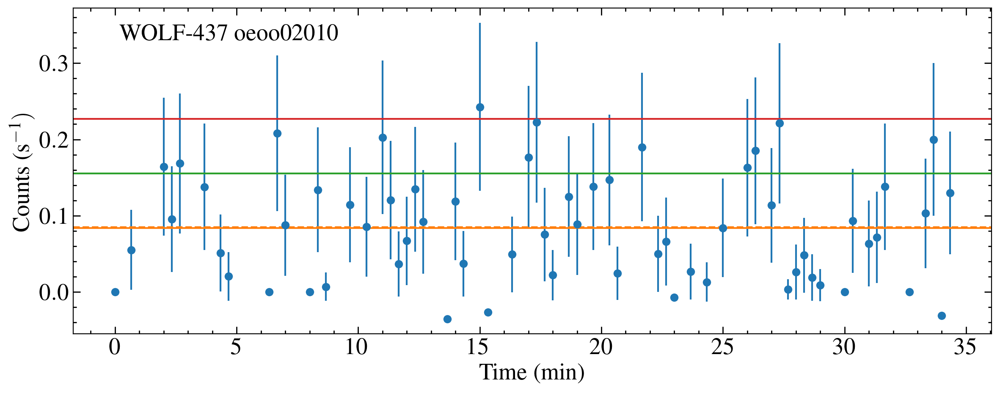

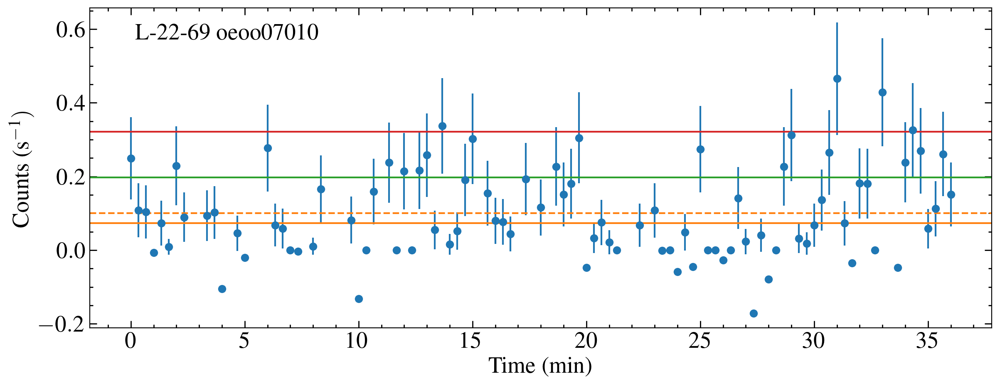

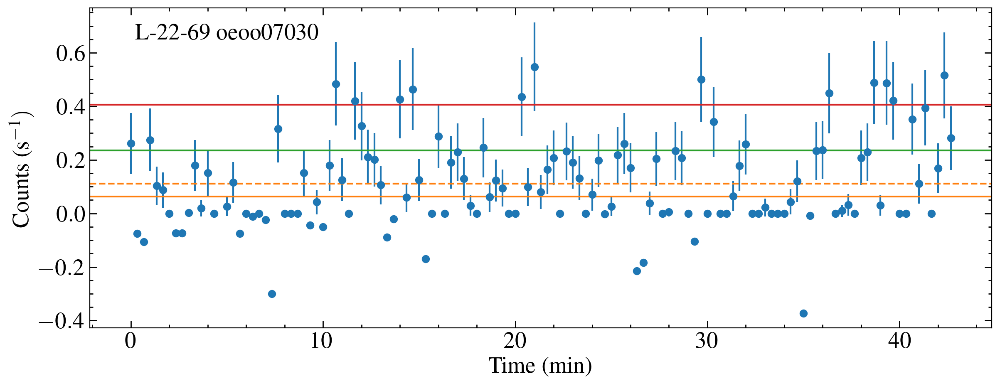

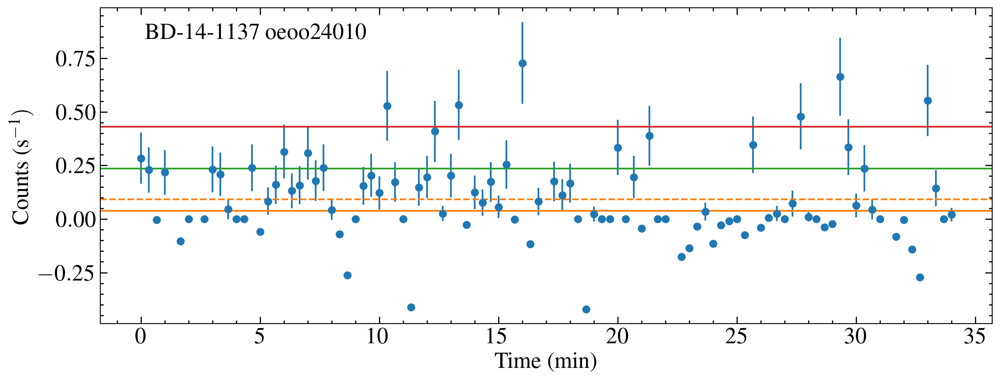

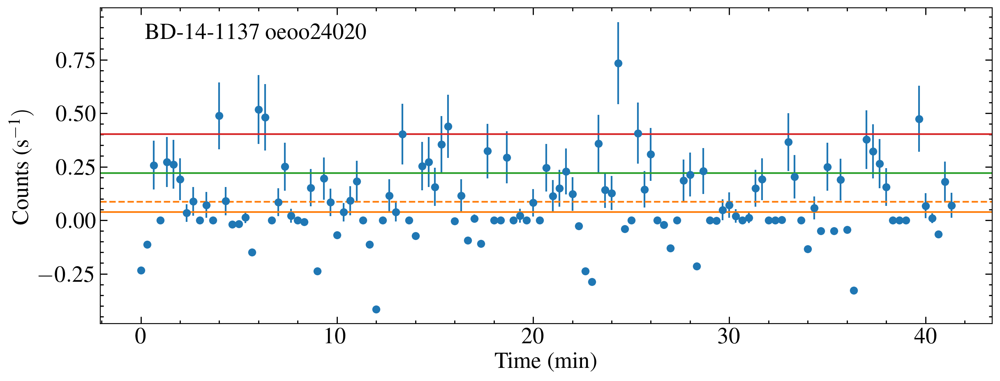

...

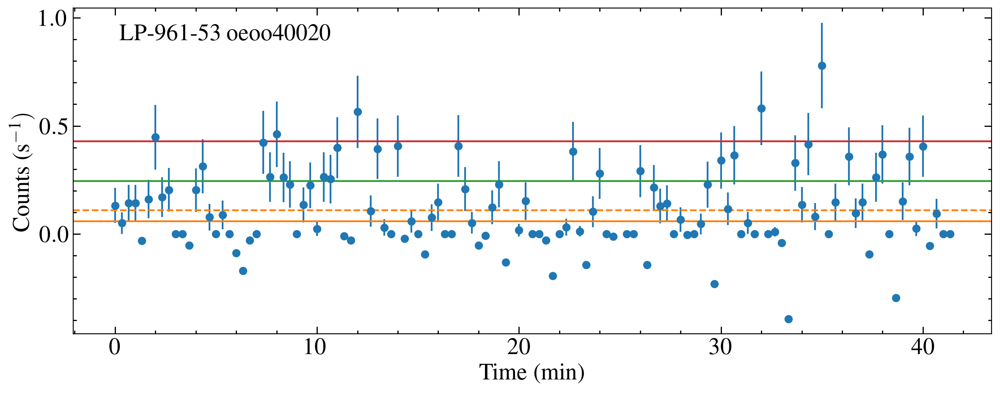

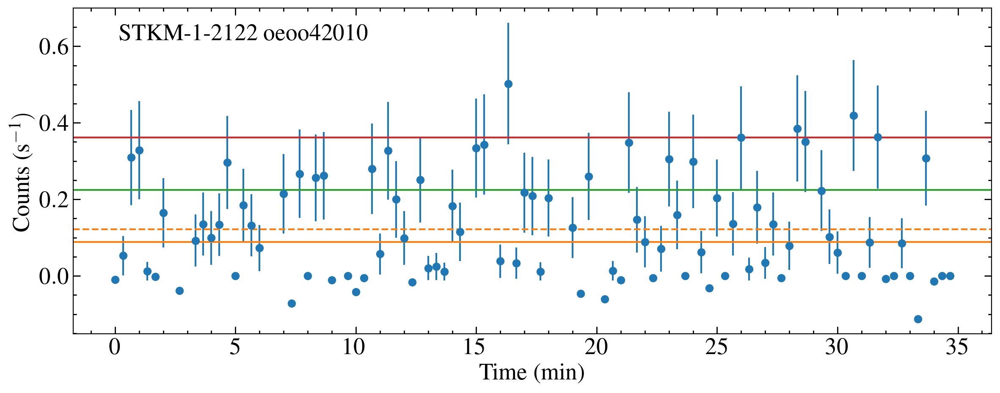

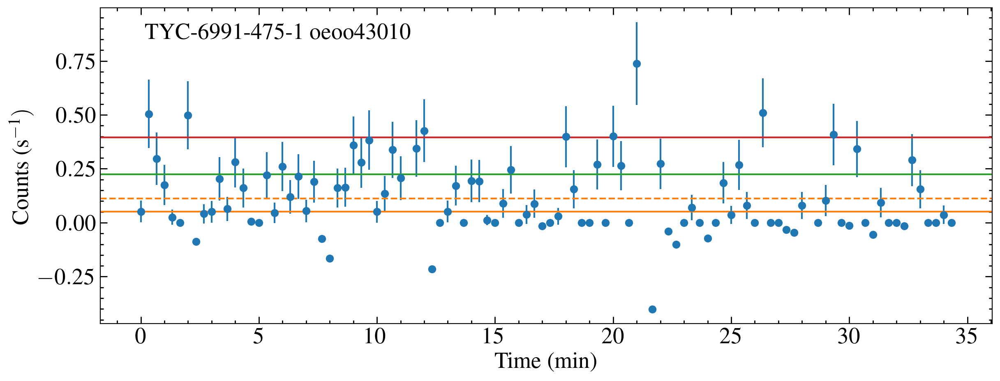

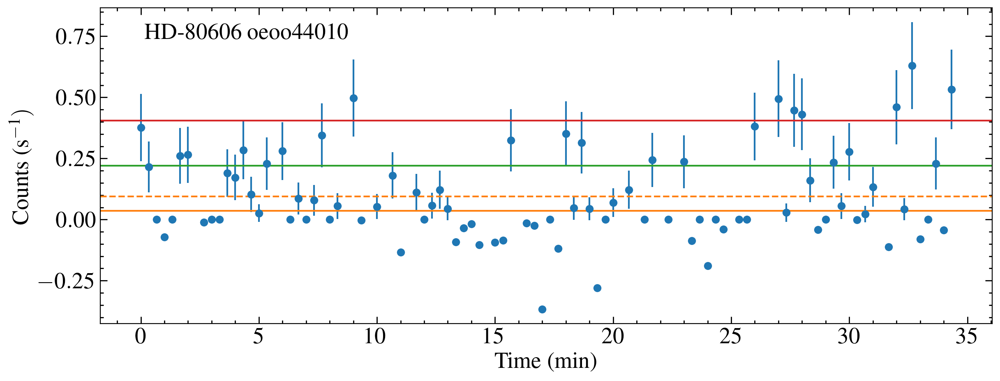

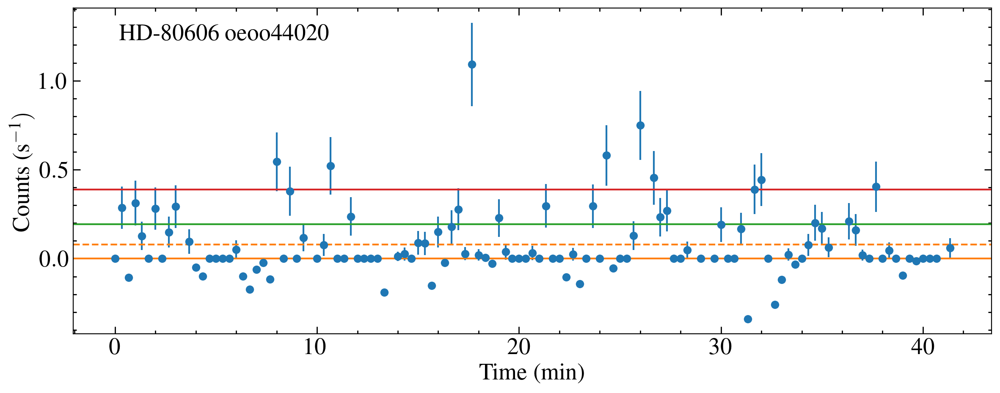

In [55]:
def wavelength_edges(w):
    """
    Calulates w0 and w1
    """
    diff = np.diff(w)
    diff0 = np.concatenate((np.array([diff[0]]), diff)) #adds an extravalue to make len(diff) = len(w)
    diff1 = np.concatenate((diff, np.array([diff[-1]]))) #adds an extravalue to make len(diff) = len(w)
    w0 = w - diff0/2.
    w1 = w + diff1/2.
    return w0, w1

for x in new_x1ds:   
    fig, ax = plt.subplots()
    hdul = fits.open(x)
    print(hdul[0].header['TARGNAME'])
    time = []
    flux = []
    error = []
    error_sqrt = []
    hdul = fits.open(x)
    band = [1230, 1700]
    for ext in hdul[1::]:
        hdr = ext.header
        ti = (hdr['EXPSTART']+hdr['EXPEND'])/2 #work out the mid-point of the time bin and add it to the time array
        time.append(ti)
        data = ext.data
        if grating == 'e140m': 
            w, f, e , dq = (data['WAVELENGTH'], data['NET'], data['NET_ERROR'], data['DQ'])
            w, f, e , dq = echelle_coadd_dq(w, f,e, dq, nclip =10, find_ratio =False)
        else:
            data = data[0]
            w, f, e , dq = (data['WAVELENGTH'], data['NET'], data['NET_ERROR'], data['DQ'])
        #w, f, e , dq = (data['WAVELENGTH'], data['FLUX'], data['ERROR'], data['DQ']) #uncomment this line for flux-calibrated light curves
        w0, w1 = wavelength_edges(w) 
        mask  = (w > band[0]) & (w < band[1]) & (dq == 0)
        w, w0, w1, f, e = w[mask], w0[mask], w1[mask], f[mask], e[mask]
        fi = np.sum(f*(w1-w0))
        ei = (np.sum(e**2 * (w1-w0)**2))**0.5
        flux.append(fi)
        error.append(ei)
        ei = ((fi*t_bin)**0.5)/t_bin # sqrt total counts 
        error_sqrt.append(ei) #better approach for these low-signal spectra
        
        
    
    hdul.close()    
    time, flux, error = np.array(time), np.array(flux), np.array(error)
    t0 = time[0]
    tplot = ((time - t0)*u.d).to(u.min)
    # ax.errorbar(time-t0, flux, yerr = error, marker='o', ls='none') #plot the light curve
    ax.errorbar(tplot, flux, yerr = error_sqrt, marker='o', ls='none') #plot the light curve
    ax.set_ylabel('Counts (s$^{-1})$')
    # ax.set_xlabel('Time (MJD-{})'.format(t0))
    ax.set_xlabel('Time (min)')

    mean, med, std = np.mean(flux),np.median(flux), np.std(flux) 
    ax.axhline(np.median(flux), c='C1')
    ax.axhline(mean, c='C1', ls ='--')
    ax.axhline(np.median(flux)+std, c='C2')
    ax.axhline(np.median(flux)+2*std, c='C3')
    ax.annotate('{} {}'.format(hdul[0].header['TARGNAME'], hdul[0].header['ROOTNAME']), (0.05, 0.95), xycoords='axes fraction', va='top', ha='left')

    #estimate of flux w/wo flares , 1 sigma is a good cut off
    flaremask = (flux < (med +std))
    noflare_mean= np.mean(flux[flaremask])
    flare_mean= np.mean(flux)
    print(noflare_mean, flare_mean,flare_mean/noflare_mean, ((flare_mean-noflare_mean)/flare_mean)*100 )
    

    
    
    # plt.show()
    
    # print(hdul[0].header['ROOTNAME'])
    # for ext in hdul[1::]: #spectra in every extension after the first
    #     data = ext.data[0]
    #     ax.step(data['WAVELENGTH'], data['FLUX'], where='mid', alpha=0.5)
    #     # plt.step(data['WAVELENGTH'], data['ERROR'], alpha =0.5, where='mid')
    #     ax.set_ylim(0, 1.1*max(data['FLUX']))
    #     # plt.show()
    # hdul.close()
    # plt.show()
    

In [48]:
# plt.plot(w, f)
# plt.plot(w, e)

nice flare in LHS 2686, quick look at TESS TIC 198511612. Nothing much happening

In [49]:
# import lightkurve as lk
# search_result = lk.search_lightcurve('TIC 198511612')
# search_result

In [50]:
# lc120s = []
# for i, sr in enumerate(search_result):
#     if sr.exptime[0].value == 120 and sr.author[0] == 'SPOC':
#         # print(i)
#         lc120s.append(i)
# #         print(sr./#[0])
#         lc = sr.download(download_dir='mastDownload/')
#         lc.remove_outliers().plot()
# # print(lc120s)

In [51]:
savepath = '/media/david/2tb_ext_hd/hddata/meats/flare_search/light_curves/'

BD-14-1137


/tmp/ipykernel_265135/3390710677.py:37: RuntimeWarning: invalid value encountered in scalar power
  ei = ((fi*t_bin)**0.5)/t_bin # sqrt total counts


BD-20-2976
CD-23-12010
CD-38-3220
HATS-72
HD-120411
HD-15337
HD-80606
L-22-69
LP-961-53
STKM-1-2122
TYC-6991-475-1
WOLF-437


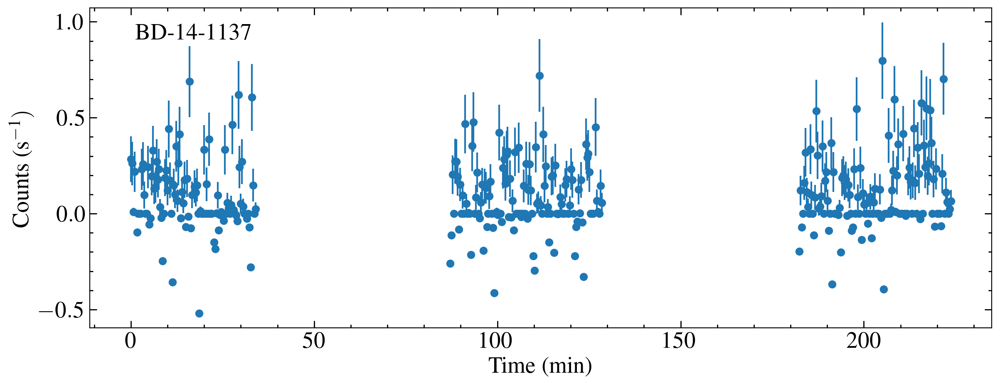

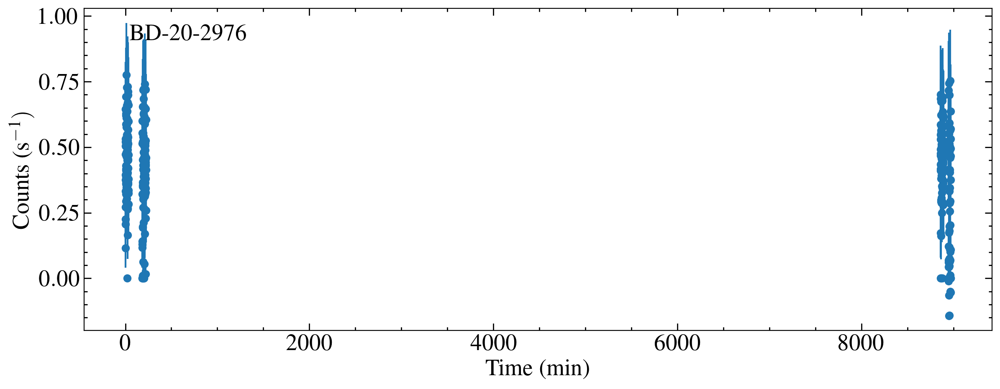

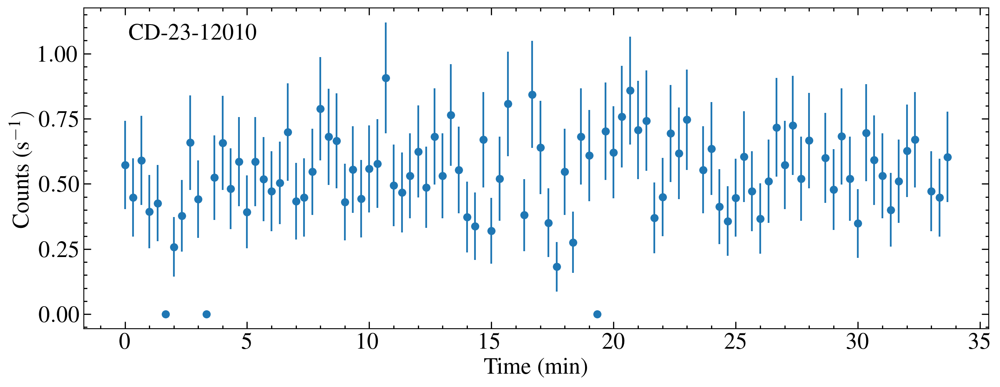

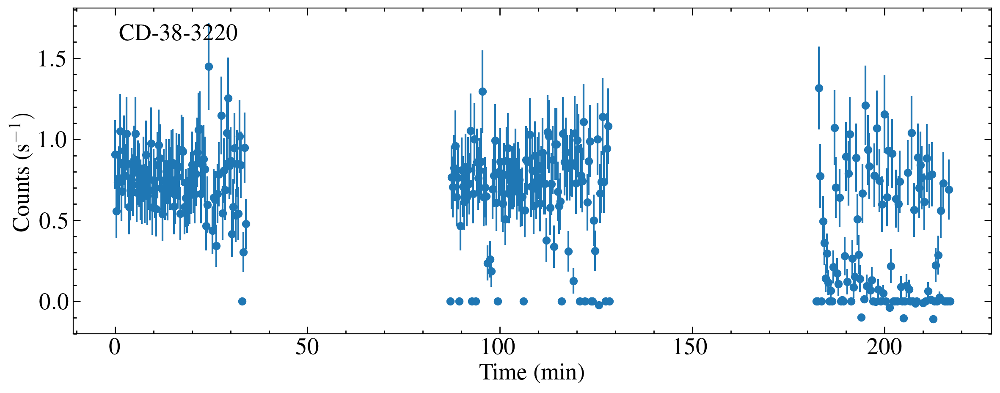

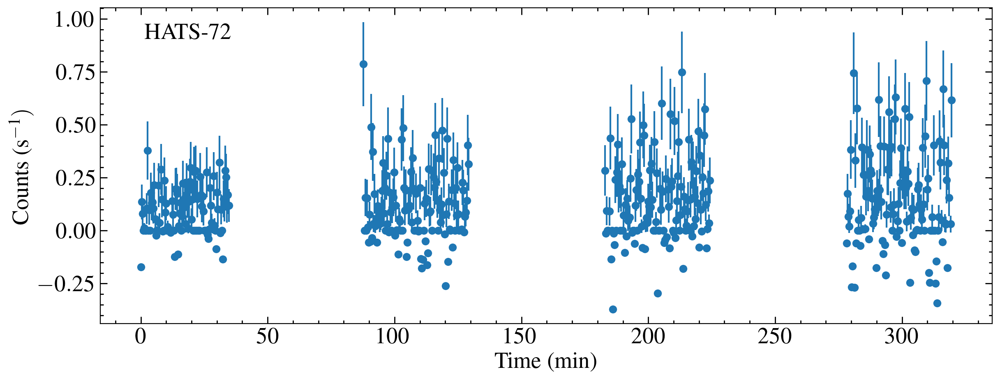

...

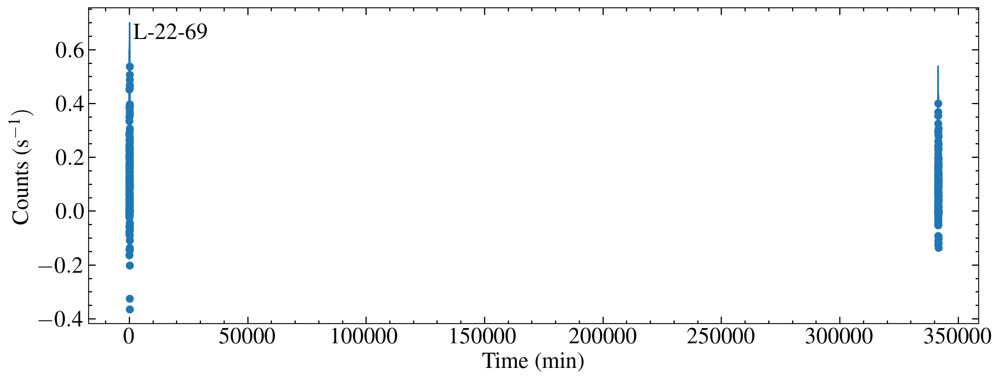

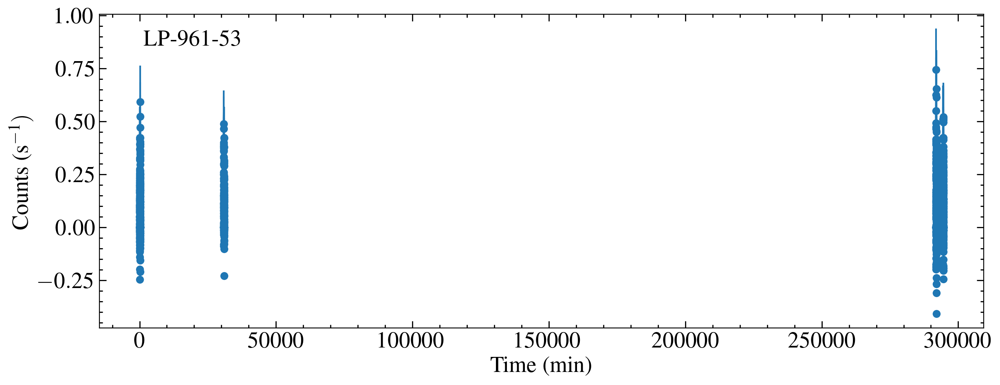

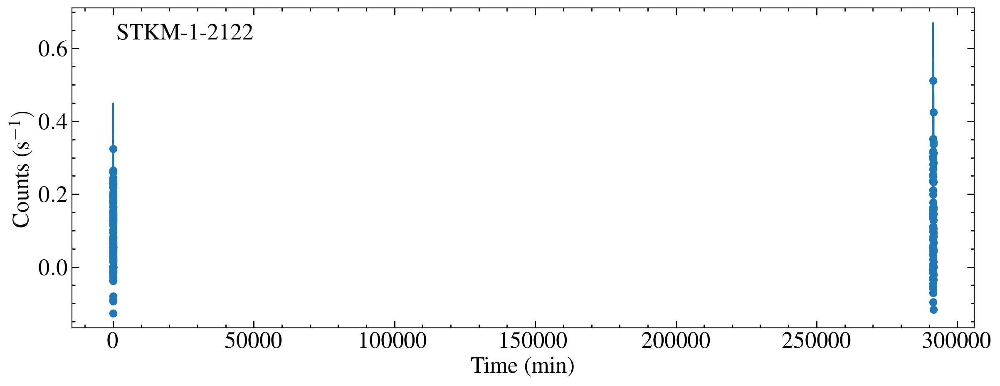

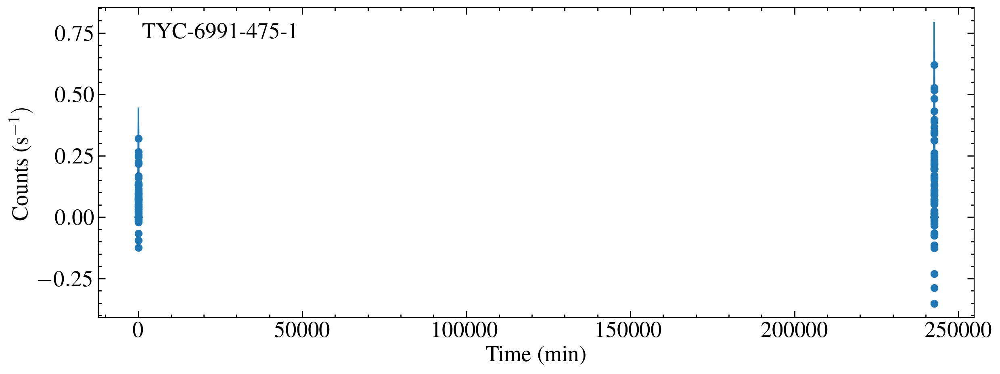

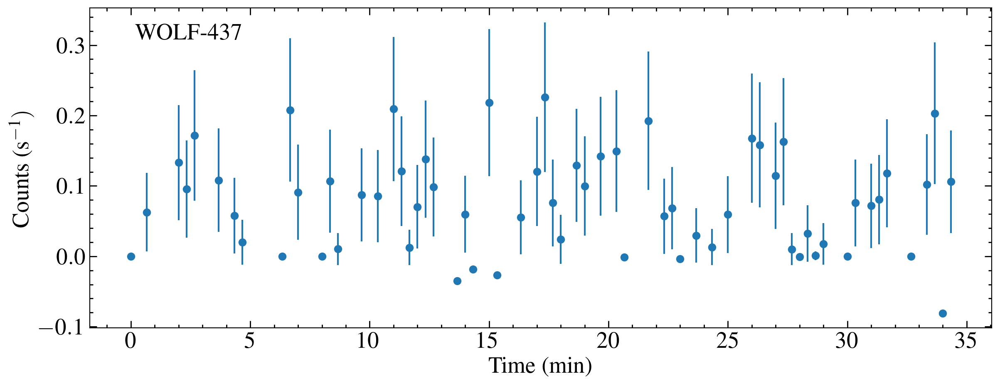

In [56]:
def wavelength_edges(w):
    """
    Calulates w0 and w1
    """
    diff = np.diff(w)
    diff0 = np.concatenate((np.array([diff[0]]), diff)) #adds an extravalue to make len(diff) = len(w)
    diff1 = np.concatenate((diff, np.array([diff[-1]]))) #adds an extravalue to make len(diff) = len(w)
    w0 = w - diff0/2.
    w1 = w + diff1/2.
    return w0, w1

band = [1250, 1700]

for star in stars:
    print(star)
    fig, ax = plt.subplots()
    time = []
    flux = []
    error = []
    for x in new_x1ds:   
        hdul = fits.open(x)
        if hdul[0].header['TARGNAME'] == star: 
            for ext in hdul[1::]:
                data = ext.data[0]
                hdr = ext.header
                ti = (hdr['EXPSTART']+hdr['EXPEND'])/2 #work out the mid-point of the time bin and add it to the time array
                time.append(ti)
                w, f, e , dq = (data['WAVELENGTH'], data['NET'], data['NET_ERROR'], data['DQ'])
                #w, f, e , dq = (data['WAVELENGTH'], data['FLUX'], data['ERROR'], data['DQ']) #uncomment this line for flux-calibrated light curves
                w0, w1 = wavelength_edges(w) 
                mask  = (w > band[0]) & (w < band[1]) & (dq == 0)
                w, w0, w1, f, e = w[mask], w0[mask], w1[mask], f[mask], e[mask]
                fi = np.sum(f*(w1-w0))
                # ei = (np.sum(e**2 * (w1-w0)**2))**0.5
                flux.append(fi)
                # error.append(ei)
                ei = ((fi*t_bin)**0.5)/t_bin # sqrt total counts 
                error.append(ei) #better approach for these low-signal spectra
                
                
        
        hdul.close()    
    time, flux, error = np.array(time), np.array(flux), np.array(error)
    args = np.argsort(time)
    time, flux, error = time[args], flux[args], error[args]
    t0 = time[0]
    tplot = ((time - t0)*u.d).to(u.min)
    # ax.errorbar(time-t0, flux, yerr = error, marker='o', ls='none') #plot the light curve
    ax.errorbar(tplot, flux, yerr = error, marker='o', ls='none') #plot the light curve
    ax.set_ylabel('Counts (s$^{-1})$')
    # ax.set_xlabel('Time (MJD-{})'.format(t0))
    ax.set_xlabel('Time (min)')
    ax.annotate(star, (0.05, 0.95), xycoords='axes fraction', va='top', ha='left')
    
    # plt.show()

    savdat = Table([time*cds.MJD, flux/u.s, error/u.s], names=['MJD', 'COUNTS', 'COUNTS_ERROR'])
    savdat.write('{}{}_{}_{}s_lc.ecsv'.format(savepath, star, grating, t_bin), overwrite=True)
    
        # print(hdul[0].header['ROOTNAME'])
        # for ext in hdul[1::]: #spectra in every extension after the first
        #     data = ext.data[0]
        #     ax.step(data['WAVELENGTH'], data['FLUX'], where='mid', alpha=0.5)
        #     # plt.step(data['WAVELENGTH'], data['ERROR'], alpha =0.5, where='mid')
        #     ax.set_ylim(0, 1.1*max(data['FLUX']))
        #     # plt.show()
        # hdul.close()
        # plt.show()
        